In [56]:
import numpy as np
import pandas as pd

from prophet import Prophet
from prophet.plot import plot_plotly, plot_components_plotly

from matplotlib import pyplot as plt

from statsmodels.tsa.statespace.sarimax import SARIMAX

from catboost import (CatBoostRegressor, Pool, cv, FeaturesData, MetricVisualizer)
from catboost.utils import get_roc_curve, eval_metric

from sklearn.metrics import root_mean_squared_error, r2_score
from sklearn.model_selection import TimeSeriesSplit

import cufflinks
cufflinks.go_offline(connected=True)

from plotly.subplots import make_subplots
from plotly.offline import init_notebook_mode, iplot
import plotly.express as px
import plotly.graph_objects as go
init_notebook_mode(connected=True)

In [ ]:
df: pd.DataFrame = pd.read_pickle("./prepared-dataset.pkl")
df

,Дата вылета,Номер рейса,Аэропорт вылета,Аэропорт прилета,Время вылета,Время прилета,Емкость кабины,LF Кабина,Бронирования по кабинам,Тип ВС,...,Кол-во вылетов всех рейсов (2 недели),Кол-во вылетов всех рейсов (месяц),Окно вылетов всех рейсов (день),Окно вылетов всех рейсов (неделя),Окно вылетов всех рейсов (2 недели),Окно вылетов всех рейсов (месяц),Окно вылетов рейса (день),Окно вылетов рейса (неделя),Окно вылетов рейса (2 недели),Окно вылетов рейса (месяц)
0,2024-08-01,1479,ABA,SVO,10:00:00,11:00:00,167,1.0299,172,32B,...,251,1979,39.0,403.0,842.0,1782.0,3.0,6.0,12.0,27.0
1,2024-08-01,427,SSH,SVO,16:30:00,22:30:00,28,0.1071,3,333,...,251,1979,8.0,372.0,811.0,1751.0,2.0,5.0,10.0,23.0
2,2024-08-01,275,HKT,SVO,10:35:00,16:40:00,375,0.5467,205,77W,...,251,1979,7.0,371.0,810.0,1750.0,1.0,4.0,9.0,22.0
3,2024-08-01,275,HKT,SVO,10:35:00,16:40:00,24,0.2500,6,77W,...,251,1979,6.0,370.0,809.0,1749.0,3.0,6.0,11.0,23.0
4,2024-08-01,275,HKT,SVO,10:35:00,16:40:00,28,0.2500,7,77W,...,251,1979,5.0,369.0,808.0,1748.0,2.0,5.0,10.0,22.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
19264,2025-06-02,1009,KGD,SVO,03:00:00,06:30:00,29,0.5517,16,32B,...,459,114,24.0,423.0,893.0,1843.0,2.0,14.0,28.0,60.0
19265,2025-06-02,1009,KGD,SVO,03:00:00,06:30:00,138,1.1014,152,32B,...,459,114,25.0,424.0,894.0,1844.0,1.0,13.0,27.0,59.0
19266,2025-06-02,1018,SVO,KGD,11:50:00,13:35:00,16,0.8750,14,32B,...,459,114,26.0,425.0,895.0,1845.0,2.0,14.0,28.0,60.0
19267,2025-06-02,1018,SVO,KGD,11:50:00,13:35:00,138,1.0290,142,32B,...,459,114,28.0,427.0,897.0,1847.0,2.0,14.0,28.0,60.0


In [77]:
fig = px.scatter(
    df,
    x="Дата вылета",
    y="Бронирования по кабинам",
    color='Номер рейса',
    symbol='Код кабины',
    hover_data=["Дата вылета", "Время вылета",
                "Город аэропорта вылета", "Город аэропорта прилета",
                "Страна аэропорта вылета", "Страна аэропорта прилета",
                "Международный рейс", "Расстояние между аэропортами"]
)
fig.show()

In [81]:
fig = px.scatter(
    df,
    x="Дата вылета",
    y="Кол-во вылетов рейса (месяц)",
    color='Номер рейса',
    hover_data=["Дата вылета", "Время вылета",
                "Город аэропорта вылета", "Город аэропорта прилета",
                "Страна аэропорта вылета", "Страна аэропорта прилета",
                "Международный рейс", "Расстояние между аэропортами"]
)
fig.show()

In [180]:
fig1 = px.scatter(
    df,
    x="Дата вылета",
    y="Окно вылетов рейса (месяц)",
    color='Номер рейса'
)
fig2 = px.scatter(
    df,
    x="Дата вылета",
    y="Кол-во вылетов рейса (месяц)",
    symbol='Номер рейса'
)
fig2.update_traces(yaxis="y2")

subplot_fig = make_subplots(specs=[[{"secondary_y": True}]])
subplot_fig.add_traces(fig1.data + fig2.data)
subplot_fig.update_layout(yaxis=dict(title="Окно вылетов рейса"), yaxis2=dict(title="Кол-во вылетов рейса"))

subplot_fig.show()

In [36]:
mdf = df[['Код кабины', "Дата вылета", "LF Кабина", "Номер рейса"]].copy()
mdf = mdf[mdf['Номер рейса'] == "427"][mdf["Код кабины"] == "Y"]
mdf = mdf.rename(columns={"Дата вылета": "ds", "LF Кабина": "y"})

model = Prophet(yearly_seasonality=False, daily_seasonality=False, weekly_seasonality=True)
model.fit(mdf)

/var/folders/xw/psrqspw174nc8yg0w2y8lxdh0000gn/T/ipykernel_3265/291713803.py:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

14:13:52 - cmdstanpy - INFO - Chain [1] start processing
14:13:53 - cmdstanpy - INFO - Chain [1] done processing


In [37]:
forecast = model.predict(mdf)

In [38]:
plot_plotly(model, forecast)

In [50]:
sdf = df[['Код кабины', "Дата вылета", "LF Кабина", "Номер рейса"]].copy()
sdf = sdf[sdf['Номер рейса'] == "427"][sdf["Код кабины"] == "Y"]
sdf = sdf.sort_values('Дата вылета')
sdf = sdf.set_index('Дата вылета')

ts = sdf["LF Кабина"].resample("D").mean()
ts = ts.fillna(method="ffill")

model = SARIMAX(ts, order=(1,1,1), seasonal_order=(1,1,1,7))
fit = model.fit(disp=False)

forecast = fit.get_forecast(steps=60)  # 2 месяца вперёд
pred = forecast.predicted_mean
conf_int = forecast.conf_int()

/var/folders/xw/psrqspw174nc8yg0w2y8lxdh0000gn/T/ipykernel_3265/4184348560.py:2: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.

/var/folders/xw/psrqspw174nc8yg0w2y8lxdh0000gn/T/ipykernel_3265/4184348560.py:7: FutureWarning:

Series.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.

/Library/Frameworks/Python.framework/Versions/3.13/lib/python3.13/site-packages/statsmodels/base/model.py:607: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



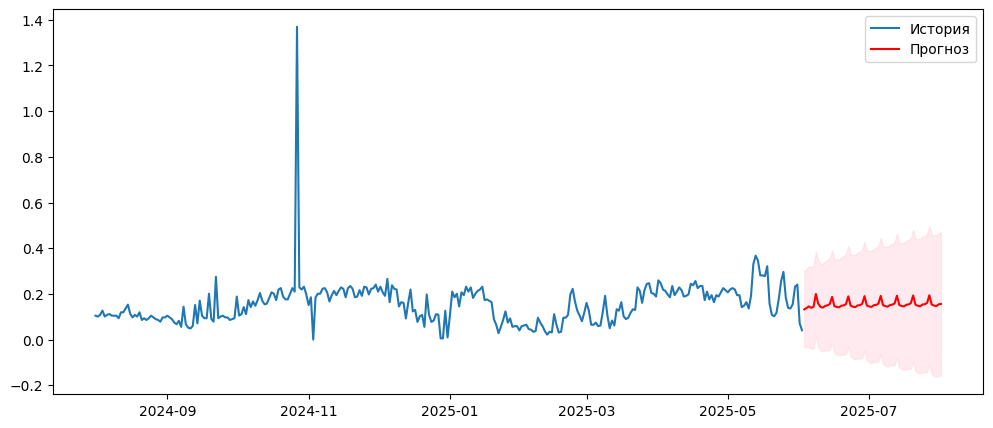

In [51]:
plt.figure(figsize=(12,5))
plt.plot(ts, label="История")
plt.plot(pred, label="Прогноз", color="red")
plt.fill_between(conf_int.index,
                 conf_int.iloc[:, 0],
                 conf_int.iloc[:, 1], color="pink", alpha=0.3)
plt.legend()
plt.show()

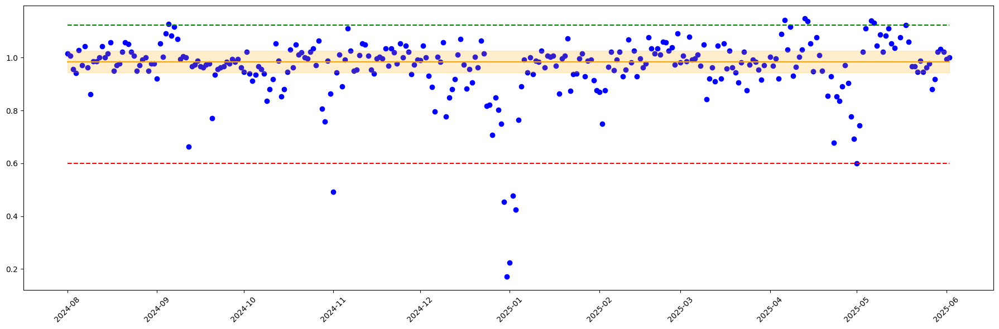

In [80]:
import pandas as pd
import matplotlib.pyplot as plt

# Группировка с квантилями
stats = df.groupby(['Номер рейса', 'Код кабины'])['LF Кабина'].agg(
    min_LF=lambda x: x.quantile(0.02),      # 5-й процентиль вместо min
    max_LF=lambda x: x.quantile(0.98),      # 95-й процентиль вместо max
    median_LF='median',                     # медиана вместо среднего
    iqr_LF=lambda x: x.quantile(0.75) - x.quantile(0.25)  # межквартильный размах
).reset_index()

# Объединяем с исходным df
df_expanded = df.merge(stats, on=['Номер рейса', 'Код кабины'], how='left')

# Фильтруем нужную комбинацию рейса и кабины
flight_number = "233"
cabin_code = "Y"
df_plot = df_expanded[(df_expanded['Номер рейса'] == flight_number) & (df_expanded['Код кабины'] == cabin_code)]

# Строим график
plt.figure(figsize=(18,6))

# Scatter — точки вылетов
plt.scatter(df_plot['Дата вылета'], df_plot['LF Кабина'], color='blue', label='LF рейса')

# Линии 5-й и 95-й процентилей
plt.plot(df_plot['Дата вылета'], df_plot['min_LF'], color='red', linestyle='--', label='top% квантиль')
plt.plot(df_plot['Дата вылета'], df_plot['max_LF'], color='green', linestyle='--', label='bottom% квантиль')

# Линия медианы
plt.plot(df_plot['Дата вылета'], df_plot['median_LF'], color='orange', linestyle='-', label='Медиана')

# Закрашенная область ±0.5*IQR вокруг медианы
plt.fill_between(
    df_plot['Дата вылета'],
    df_plot['median_LF'] - 0.5*df_plot['iqr_LF'],
    df_plot['median_LF'] + 0.5*df_plot['iqr_LF'],
    color='orange',
    alpha=0.2,
    label='±0.5 IQR'
)

plt.xticks(rotation=45)
plt.tight_layout()
plt.show()


In [78]:
fig = px.scatter(
    df,
    x="Дата вылета",
    y="Доход пасс (рейс/день)",
    color='Номер рейса',
    symbol='Код кабины',
    hover_data=["Дата вылета", "Время вылета",
                "Город аэропорта вылета", "Город аэропорта прилета",
                "Страна аэропорта вылета", "Страна аэропорта прилета",
                "Международный рейс", "Расстояние между аэропортами"]
)
fig.show()

In [79]:
fig = px.scatter(
    df,
    x="Дата вылета",
    y="Доход пасс",
    color='Номер рейса',
    symbol='Код кабины',
    hover_data=["Дата вылета", "Время вылета",
                "Город аэропорта вылета", "Город аэропорта прилета",
                "Страна аэропорта вылета", "Страна аэропорта прилета",
                "Международный рейс", "Расстояние между аэропортами"]
)
fig.show()